# ABOUT THE DATASET: Flight Delays and Cancellations
The dataset contains 274,964 rows and 34 columns, providing detailed information about flights, including schedules, delays, cancellations, and various contributing factors. Below is a brief description of each column:

## Column	Description:
- **_c0, Unnamed: 0, Unnamed: 0.1**	Redundant index columns from previous processing. Can be removed.
- **YEAR** Year of the flight ( 2015).
- **MONTH** Month of the flight (1 for January, 12 for December).
- **DAY**	Day of the month the flight took place.
- **DAY_OF_WEEK**	Day of the week (1 = Monday, 7 = Sunday).
- **AIRLINE**	Two-letter airline code (e.g., AA for American Airlines).
- **FLIGHT_NUMBER:**		Unique number identifying the flight.
- **TAIL_NUMBER:**		Unique aircraft identifier.
- **ORIGIN_AIRPORT:**		Code of the airport where the flight originated.
- **DESTINATION_AIRPORT:**	Code of the destination airport.
- **SCHEDULED_DEPARTURE:**	Scheduled departure time (HHMM format).
- **DEPARTURE_TIME:**	Actual departure time (HHMM format).
- **DEPARTURE_DELAY:**	Delay in departure time (minutes).
- **TAXI_OUT:**	Time spent taxiing out from the gate (minutes).
- **WHEELS_OFF:**	Time the plane took off (HHMM format).
- **SCHEDULED_TIME:**	Scheduled flight duration (minutes).
- **ELAPSED_TIME:**	Actual flight duration (minutes).
- **AIR_TIME:**	Time spent in the air (minutes).
- **DISTANCE:**	Distance between origin and destination (miles).
- **WHEELS_ON:**	Time the plane landed (HHMM format).
- **TAXI_IN:**	Time spent taxiing to the gate after landing (minutes).
- **SCHEDULED_ARRIVAL:**	Scheduled arrival time (HHMM format).
- **ARRIVAL_TIME:**	Actual arrival time (HHMM format).
- **ARRIVAL_DELAY:**	Delay in arrival time (minutes).
- **DIVERTED:**	Indicates if the flight was diverted (1 = Yes, 0 = No).
- **CANCELLED:** Indicates if the flight was canceled (1 = Yes, 0 = No).
- **CANCELLATION_REASON:**	Reason for cancellation (A = Airline, B = Weather, C = NAS, D = Security).
- **AIR_SYSTEM_DELAY:**	Minutes of delay caused by the air traffic control system.
- **SECURITY_DELAY:**	Minutes of delay caused by security issues.
- **AIRLINE_DELAY:**	Minutes of delay caused by airline-specific issues.
- **LATE_AIRCRAFT_DELAY:**	Minutes of delay due to the late arrival of the aircraft.
- **WEATHER_DELAY:**	Minutes of delay caused by weather conditions.


#  Step 1: Data Loading and Initial Exploration
- Load the data and perform an initial exploration

In [0]:
# Import necessary libraries
from pyspark.sql import SparkSession
from pyspark.sql.functions import col





In [0]:
# Step 1.1: Load Data
# Load the dataset into a Spark DataFrame
file_path = "dbfs:/FileStore/shared_uploads/c0909095@mylambton.ca/flights.csv"  
flights_df = spark.read.csv(file_path, header=True, inferSchema=True)




In [0]:
# Step 1.2: Initial Exploration
# Display the schema to understand column names and types
flights_df.printSchema()

root
 |-- _c0: integer (nullable = true)
 |-- Unnamed: 0: integer (nullable = true)
 |-- Unnamed: 0.1: integer (nullable = true)
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULE

In [0]:
# Since _c0, Unnamed: 0, Unnamed: 0.1 are Redundant index columns from previous processing. Thus, they can be removed.
# List of columns to drop: all columns starting with 'Unnamed:' and 'c0'
columns_to_drop = [col for col in flights_df.columns if col.startswith('Unnamed:') or col == '_c0']

# Drop the columns from the DataFrame
flights_df = flights_df.drop(*columns_to_drop)

# Verify the changes
flights_df.printSchema()


root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = true)
 |-- DEPARTURE_DELAY: double (nullable = true)
 |-- TAXI_OUT: double (nullable = true)
 |-- WHEELS_OFF: double (nullable = true)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = true)
 |-- AIR_TIME: double (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = true)
 |-- TAXI_IN: double (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = true)
 |-- ARRIVAL_DELAY: double (nullable = true

In [0]:
# Display all column names in the dataset
columns = flights_df.columns
print(f"Total number of columns: {len(columns)}")
print("Column Names:", columns)


Total number of columns: 31
Column Names: ['YEAR', 'MONTH', 'DAY', 'DAY_OF_WEEK', 'AIRLINE', 'FLIGHT_NUMBER', 'TAIL_NUMBER', 'ORIGIN_AIRPORT', 'DESTINATION_AIRPORT', 'SCHEDULED_DEPARTURE', 'DEPARTURE_TIME', 'DEPARTURE_DELAY', 'TAXI_OUT', 'WHEELS_OFF', 'SCHEDULED_TIME', 'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'WHEELS_ON', 'TAXI_IN', 'SCHEDULED_ARRIVAL', 'ARRIVAL_TIME', 'ARRIVAL_DELAY', 'DIVERTED', 'CANCELLED', 'CANCELLATION_REASON', 'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY']


In [0]:

# Show the first 9 columns 
df_1 = flights_df.select(flights_df.columns[:9])
df_1.show(5)


+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
|YEAR|MONTH|DAY|DAY_OF_WEEK|AIRLINE|FLIGHT_NUMBER|TAIL_NUMBER|ORIGIN_AIRPORT|DESTINATION_AIRPORT|
+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
|2015|   11| 28|          6|     DL|         1590|     N971AT|           CAE|                ATL|
|2015|   11|  2|          1|     AA|         2516|     N3CVAA|           ORD|                DEN|
|2015|    8| 22|          6|     AS|           93|     N317AS|           SEA|                ANC|
|2015|   11|  9|          1|     AA|         2383|     N871AA|           MCO|                DFW|
|2015|    6| 12|          5|     US|         1978|     N833AW|           CLE|                CLT|
+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
only showing top 5 rows



In [0]:
 # Show the first 5 rows of the dataset for next 7 columns
df_2 = flights_df.select(flights_df.columns[9:16])
df_2.show(5)

+-------------------+--------------+---------------+--------+----------+--------------+------------+
|SCHEDULED_DEPARTURE|DEPARTURE_TIME|DEPARTURE_DELAY|TAXI_OUT|WHEELS_OFF|SCHEDULED_TIME|ELAPSED_TIME|
+-------------------+--------------+---------------+--------+----------+--------------+------------+
|                700|         655.0|           -5.0|    17.0|     712.0|          68.0|        61.0|
|               1715|        1743.0|           28.0|    40.0|    1823.0|         164.0|       177.0|
|               1355|        1353.0|           -2.0|    20.0|    1413.0|         220.0|       206.0|
|                650|         652.0|            2.0|    16.0|     708.0|         181.0|       172.0|
|                705|         700.0|           -5.0|    12.0|     712.0|          93.0|        92.0|
+-------------------+--------------+---------------+--------+----------+--------------+------------+
only showing top 5 rows



In [0]:
 # Show the first 5 rows of the dataset for next 9 columns
df_3 = flights_df.select(flights_df.columns[16:25])
df_3.show(5)

+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|AIR_TIME|DISTANCE|WHEELS_ON|TAXI_IN|SCHEDULED_ARRIVAL|ARRIVAL_TIME|ARRIVAL_DELAY|DIVERTED|CANCELLED|
+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|    39.0|     192|    751.0|    5.0|              808|       756.0|        -12.0|       0|        0|
|   126.0|     888|   1929.0|   11.0|             1859|      1940.0|         41.0|       0|        0|
|   182.0|    1448|   1615.0|    4.0|             1635|      1619.0|        -16.0|       0|        0|
|   142.0|     985|    830.0|   14.0|              851|       844.0|         -7.0|       0|        0|
|    71.0|     430|    823.0|    9.0|              838|       832.0|         -6.0|       0|        0|
+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
only showing top 5 rows



In [0]:
 # Show the first 5 rows of the dataset for next 6 columns
df_4 = flights_df.select(flights_df.columns[25:31])
df_4.show(5)

+-------------------+----------------+--------------+-------------+-------------------+-------------+
|CANCELLATION_REASON|AIR_SYSTEM_DELAY|SECURITY_DELAY|AIRLINE_DELAY|LATE_AIRCRAFT_DELAY|WEATHER_DELAY|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
|               null|            null|          null|         null|               null|         null|
|               null|            13.0|           0.0|         28.0|                0.0|          0.0|
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
only showing top 5 rows



In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,null,null,null,null,null,null
2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,null,13.0,0.0,28.0,0.0,0.0
2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,null,null,null,null,null,null
2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,null,null,null,null,null,null
2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,null,null,null,null,null,null
2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,null,null,null,null,null,null
2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,null,0.0,0.0,110.0,99.0,0.0
2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,null,0.0,0.0,0.0,34.0,0.0
2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,null,null,null,null,null,null
2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,null,null,null,null,null,null


In [0]:
# Count the number of rows and columns
num_rows = flights_df.count()
num_columns = len(flights_df.columns)
print(f"The dataset contains {num_rows} rows and {num_columns} columns.")

The dataset contains 274964 rows and 31 columns.


## Questions:
1. **How many rows and columns does the dataset contain?**

Ans 1 :The dataset contains 274964 rows and 34 columns but after removing 3 redundant index columns , 31 are left

2. **What are the data types of each column?**

Ans 2.
 - **_c0:** integer (nullable = true)
 - **Unnamed:** 0: integer (nullable = true)
 - **Unnamed:** 0.1: integer (nullable = true)
 - **YEAR:**  integer (nullable = true)
 - **MONTH:**  integer (nullable = true)
 - **DAY:**  integer (nullable = true)
 - **DAY_OF_WEEK:**  integer (nullable = true)
 - **AIRLINE:**  string (nullable = true)
 - **FLIGHT_NUMBER:**  integer (nullable = true)
 - **TAIL_NUMBER:**  string (nullable = true)
 - **ORIGIN_AIRPORT:**  string (nullable = true)
 - **DESTINATION_AIRPORT:**  string (nullable = true)
 - **SCHEDULED_DEPARTURE:**  integer (nullable = true)
 - **DEPARTURE_TIME:**  double (nullable = true)
 - **DEPARTURE_DELAY:**  double (nullable = true)
 - **TAXI_OUT:**  double (nullable = true)
 - **WHEELS_OFF:**  double (nullable = true)
 - **SCHEDULED_TIME:**  double (nullable = true)
 - **ELAPSED_TIME:**  double (nullable = true)
 - **AIR_TIME:**  double (nullable = true)
 - **DISTANCE:**  integer (nullable = true)
 - **WHEELS_ON:**  double (nullable = true)
 - **TAXI_IN:**  double (nullable = true)
 - **SCHEDULED_ARRIVAL:**  integer (nullable = true)
 - **ARRIVAL_TIME:**  double (nullable = true)
 - **ARRIVAL_DELAY:**  double (nullable = true)
 - **DIVERTED:**  integer (nullable = true)
 - **CANCELLED:**  integer (nullable = true)
 - **CANCELLATION_REASON:**  string (nullable = true)
 - **AIR_SYSTEM_DELAY:**  double (nullable = true)
 - **SECURITY_DELAY:**  double (nullable = true)
 - **AIRLINE_DELAY:** double (nullable = true)
 - **LATE_AIRCRAFT_DELAY:** double (nullable = true)
 - **WEATHER_DELAY:** double (nullable = true)


# Step 2: Data Cleaning and Transformation
Handle missing values, feature engineering, and data type conversions

**Since _c0, Unnamed: 0, Unnamed: 0.1 were Redundant index columns from previous processing.Therefore, I dropped those as they were of no use in my analysis.**

In [0]:
# Count the number of columns in the DataFrame after dropping 3 columns
num_columns = len(flights_df.columns)

# Display the result
print(f"Number of columns: {num_columns}")


Number of columns: 31


### 2.1 Checking for null values in each column

In [0]:
from pyspark.sql.functions import when, isnan, count, col

# Step 2.1: Handle Missing Values

# First set of 6 columns
missing_values_1 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[:6]]
)
missing_values_1.show()

+----+-----+---+-----------+-------+-------------+
|YEAR|MONTH|DAY|DAY_OF_WEEK|AIRLINE|FLIGHT_NUMBER|
+----+-----+---+-----------+-------+-------------+
|   0|    0|  0|          0|      0|            0|
+----+-----+---+-----------+-------+-------------+



As it can be seen , there are no null values in any of the 1st 6 columns

In [0]:
# Second set of 6 columns
missing_values_2 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[6:12]]
)
missing_values_2.show()



+-----------+--------------+-------------------+-------------------+--------------+---------------+
|TAIL_NUMBER|ORIGIN_AIRPORT|DESTINATION_AIRPORT|SCHEDULED_DEPARTURE|DEPARTURE_TIME|DEPARTURE_DELAY|
+-----------+--------------+-------------------+-------------------+--------------+---------------+
|        739|             0|                  0|                  0|          4245|           4245|
+-----------+--------------+-------------------+-------------------+--------------+---------------+



**It can be seen that there are 739, 4245 and 4245 null values in TAIL_NUMBER,DEPARTURE_TIME and DEPARTURE_DELAY columns respectively and something needs to be done about them.**

In [0]:
# Third set of 6 columns
missing_values_3 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[12:18]]
)
missing_values_3.show()



+--------+----------+--------------+------------+--------+--------+
|TAXI_OUT|WHEELS_OFF|SCHEDULED_TIME|ELAPSED_TIME|AIR_TIME|DISTANCE|
+--------+----------+--------------+------------+--------+--------+
|    4393|      4393|             0|        5191|    5191|       0|
+--------+----------+--------------+------------+--------+--------+



**TAXI_OUT,WHEELS_OFF,ELAPSED_TIME,AIR_TIME have 4393,4393,5191 and 5191 null values respectively.**

In [0]:
# Fourth set of 6 columns
missing_values_4 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[18:25]]
)
missing_values_4.show()

+---------+-------+-----------------+------------+-------------+--------+---------+
|WHEELS_ON|TAXI_IN|SCHEDULED_ARRIVAL|ARRIVAL_TIME|ARRIVAL_DELAY|DIVERTED|CANCELLED|
+---------+-------+-----------------+------------+-------------+--------+---------+
|     4587|   4587|                0|        4587|         5191|       0|        0|
+---------+-------+-----------------+------------+-------------+--------+---------+



**WHEELS_ON, TAXI_IN, ARRIVAL_TIME, ARRIVAL_DELAY have 4587,4587,4587 and 5191 null values**

In [0]:
# Fifth set of columns
missing_values_5 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[25:31]]
)
missing_values_5.show()


+-------------------+----------------+--------------+-------------+-------------------+-------------+
|CANCELLATION_REASON|AIR_SYSTEM_DELAY|SECURITY_DELAY|AIRLINE_DELAY|LATE_AIRCRAFT_DELAY|WEATHER_DELAY|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
|             270531|          223101|        223101|       223101|             223101|       223101|
+-------------------+----------------+--------------+-------------+-------------------+-------------+



**CANCELLATION_REASON, AIR_SYSTEM_DELAY, SECURITY_DELAY, AIRLINE_DELAY, LATE_AIRCRAFT_DELAY, WEATHER_DELAY have a very high count of null values each having approximately 223101 null values.**

###  Dropping columns with too many missing values

**Since  AIR_SYSTEM_DELAY, SECURITY_DELAY, AIRLINE_DELAY, LATE_AIRCRAFT_DELAY, WEATHER_DELAY have a very high count of null values, therfore, I am dropping these columns.** 

In [0]:
# Drop columns with high missing values
flights_df = flights_df.drop(*[ 'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 
                                      'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY'])



In [0]:
# Fill CANCELLATION_REASON with "No Cancellation" for non-cancelled flights 
flights_df = flights_df.fillna({
    'CANCELLATION_REASON': 'No Cancellation'
})


**Though CANCELLATION_REASON column had a lot of null values, I did not drop it because I need it for my further analysis to answer the query to determine the most common reason for flight cancellations.Therefore, I replaced the null values with 'No Cancellation' instead.**

In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON
2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,No Cancellation
2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,No Cancellation
2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,No Cancellation
2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,No Cancellation
2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,No Cancellation
2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,No Cancellation
2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,No Cancellation
2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,No Cancellation
2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,No Cancellation
2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,No Cancellation


###  Filling remaining  columns with null values with either mean or median based on skewness and kurtosis score for each column

When deciding whether to impute null values with the mean or median based on skewness and kurtosis, the general approach is as follows:

### 1. Skewness:
Skewness indicates the asymmetry of the data distribution.
- If **skewness** is close to 0, the data is **approximately symmetric**, and the **mean** is a good measure of central tendency. In such cases, imputing with the **mean** is suitable.
- If **skewness** is **positive** (right skewed), the data has a tail on the right, and the **mean** is pulled towards the right. In this case, imputing with the **median** (which is more robust to skewness) is preferred.
- If **skewness** is **negative** (left skewed), the data has a tail on the left, and the **mean** is pulled towards the left. Again, imputing with the **median** is more appropriate.

### 2. Kurtosis:
Kurtosis indicates the "tailedness" or extreme values in the data distribution.
- If **kurtosis** is close to 3 (normal distribution), the data is considered **normal** in terms of its tails, and the **mean** is a reasonable choice for imputation.
- If **kurtosis** is **high** (>3), the data has heavy tails (more outliers). In this case, imputing with the **median** is usually better because it is less affected by extreme outliers.
- If **kurtosis** is **low** (<3), the data has light tails, so the **mean** can still be effective for imputation.


In [0]:
from pyspark.sql.functions import skewness, kurtosis

# List of columns to analyze
columns_to_check = [
    "TAIL_NUMBER", "DEPARTURE_TIME", "DEPARTURE_DELAY", "TAXI_OUT", "WHEELS_OFF",
    "ELAPSED_TIME", "AIR_TIME", "WHEELS_ON", "TAXI_IN", "ARRIVAL_TIME", "ARRIVAL_DELAY"
]

# Compute skewness and kurtosis for each column
for col_name in columns_to_check:
    stats = flights_df.select(
        skewness(col(col_name)).alias("skewness"),
        kurtosis(col(col_name)).alias("kurtosis")
    ).collect()[0]
    
    print(f"Column: {col_name}")
    print(f"  Skewness: {stats['skewness']}")
    print(f"  Kurtosis: {stats['kurtosis']}")


Column: TAIL_NUMBER
  Skewness: None
  Kurtosis: None
Column: DEPARTURE_TIME
  Skewness: 0.015298027748003963
  Kurtosis: -0.9589782301077174
Column: DEPARTURE_DELAY
  Skewness: 7.750838246386124
  Kurtosis: 132.42433925361757
Column: TAXI_OUT
  Skewness: 3.433114211038924
  Kurtosis: 23.189891564557858
Column: WHEELS_OFF
  Skewness: -0.018008188838045957
  Kurtosis: -0.8969181122820893
Column: ELAPSED_TIME
  Skewness: 1.3503318585754525
  Kurtosis: 2.0204375583623397
Column: AIR_TIME
  Skewness: 1.3758763355238062
  Kurtosis: 2.060315953817871
Column: WHEELS_ON
  Skewness: -0.33322854681427616
  Kurtosis: -0.43324728661332257
Column: TAXI_IN
  Skewness: 5.082768045180518
  Kurtosis: 57.176545641590266
Column: ARRIVAL_TIME
  Skewness: -0.36973796038163853
  Kurtosis: -0.36062262166244485
Column: ARRIVAL_DELAY
  Skewness: 6.589958338766056
  Kurtosis: 103.29429733222447


## Key Metrics Interpretation
1. **Skewness:**

- ~0: Symmetrical (likely normal distribution).
- 1 or <-1: Highly skewed.
- Between -1 and 1: Approximately symmetric.

2. **Kurtosis:**

- ~3: Normal distribution.
- 3: Leptokurtic (sharp peak, heavy tails, extreme outliers).
- <3: Platykurtic (flatter peak, light tails, fewer outliers).

**Column Analysis**
1. **TAIL_NUMBER:**

- Skewness: None
- Kurtosis: None.
- Interpretation: This column is likely categorical or has non-numeric values. Imputation of mean or median is not applicable here.

2. **DEPARTURE_TIME:**

- Skewness: 0.015 (symmetrical)
- Kurtosis: -0.926 (platykurtic).
- Interpretation: The distribution is almost normal. Replacing null values with the mean is appropriate.

3. **DEPARTURE_DELAY:**

- Skewness: 7.751 (highly skewed)
- Kurtosis: 132.424 (extremely leptokurtic).
- Interpretation: The column is heavily skewed with many extreme outliers. Replacing null values with the median is better.

4. **TAXI_OUT:**

- Skewness: 3.461 (highly skewed)
- Kurtosis: 23.615 (leptokurtic).
- Interpretation: Similar to DEPARTURE_DELAY, heavily skewed. Use median for imputation.

5. **WHEELS_OFF:**

- Skewness: -0.018 (symmetrical)
-  Kurtosis: -0.863 (platykurtic).
- Interpretation: The distribution is almost normal. Use mean for imputation.

6. **ELAPSED_TIME:**

- Skewness: 1.363 (moderately skewed),
- Kurtosis: 2.117 (slightly platykurtic).
- Interpretation: Moderately skewed. Depending on the level of skewness observed visually, median will be used

7. **AIR_TIME:**

- Skewness: 1.389 (moderately skewed)
-  Kurtosis: 2.158 (slightly platykurtic).
- Interpretation: Similar to ELAPSED_TIME, it’s moderately skewed. Use median for imputation.

8. **WHEELS_ON:**

- Skewness: -0.333 (symmetrical), Kurtosis: -0.433 (platykurtic).
- Interpretation: The distribution is close to normal. Use mean for imputation.

9. **TAXI_IN:**

- Skewness: 5.083 (highly skewed)
Kurtosis: 57.177 (extremely leptokurtic).
- Interpretation: Heavily skewed with many outliers. Use median for imputation.

10. **ARRIVAL_TIME:**

- Skewness: -0.370 (symmetrical)
- Kurtosis: -0.361 (platykurtic).
- Interpretation: The distribution is close to normal. Use mean for imputation.

11. **ARRIVAL_DELAY:**

- Skewness: 6.590 (highly skewed)
- Kurtosis: 103.294 (extremely leptokurtic).
- Interpretation: Heavily skewed with many outliers. Use median for imputation.

Based on the above analysis, I'll replace symmetrical columns like DEPARTURE_TIME
WHEELS_OFF
WHEELS_ON
ARRIVAL_TIME with mean and skewed column like DEPARTURE_DELAY
TAXI_OUT
ELAPSED_TIME
AIR_TIME
TAXI_IN
ARRIVAL_DELAY with median

### 1. Replace Null Values with Mean

In [0]:
from pyspark.sql.functions import mean

# Columns to replace null values with mean
mean_columns = ['DEPARTURE_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'ARRIVAL_TIME']

for column in mean_columns:
    mean_value = flights_df.select(mean(column)).collect()[0][0]
    flights_df = flights_df.fillna({column: mean_value})

print(f"Null values in {mean_columns} replaced with their mean.")


Null values in ['DEPARTURE_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'ARRIVAL_TIME'] replaced with their mean.


###  Replace Null Values with Median

In [0]:
from pyspark.sql.functions import percentile_approx

# Columns to replace null values with median
median_columns = ['DEPARTURE_DELAY', 'TAXI_OUT', 'ELAPSED_TIME', 'AIR_TIME', 'TAXI_IN', 'ARRIVAL_DELAY']

for column in median_columns:
    median_value = flights_df.select(percentile_approx(column, 0.5)).collect()[0][0]
    flights_df = flights_df.fillna({column: median_value})

print(f"Null values in {median_columns} replaced with their median.")


Null values in ['DEPARTURE_DELAY', 'TAXI_OUT', 'ELAPSED_TIME', 'AIR_TIME', 'TAXI_IN', 'ARRIVAL_DELAY'] replaced with their median.


In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON
2015,11,28,6,DL,1590,N971AT,CAE,ATL,700,655.0,-5.0,17.0,712.0,68.0,61.0,39.0,192,751.0,5.0,808,756.0,-12.0,0,0,No Cancellation
2015,11,2,1,AA,2516,N3CVAA,ORD,DEN,1715,1743.0,28.0,40.0,1823.0,164.0,177.0,126.0,888,1929.0,11.0,1859,1940.0,41.0,0,0,No Cancellation
2015,8,22,6,AS,93,N317AS,SEA,ANC,1355,1353.0,-2.0,20.0,1413.0,220.0,206.0,182.0,1448,1615.0,4.0,1635,1619.0,-16.0,0,0,No Cancellation
2015,11,9,1,AA,2383,N871AA,MCO,DFW,650,652.0,2.0,16.0,708.0,181.0,172.0,142.0,985,830.0,14.0,851,844.0,-7.0,0,0,No Cancellation
2015,6,12,5,US,1978,N833AW,CLE,CLT,705,700.0,-5.0,12.0,712.0,93.0,92.0,71.0,430,823.0,9.0,838,832.0,-6.0,0,0,No Cancellation
2015,8,9,7,OO,4669,N825SK,MSY,SLC,740,736.0,-4.0,11.0,747.0,211.0,218.0,190.0,1428,957.0,17.0,1011,1014.0,3.0,0,0,No Cancellation
2015,8,18,2,OO,5538,N930SW,SFO,MRY,1434,1813.0,219.0,12.0,1825.0,49.0,39.0,24.0,77,1849.0,3.0,1523,1852.0,209.0,0,0,No Cancellation
2015,3,20,5,WN,1978,N651SW,OKC,LAS,1955,2036.0,41.0,12.0,2048.0,165.0,158.0,142.0,986,2110.0,4.0,2040,2114.0,34.0,0,0,No Cancellation
2015,9,13,7,UA,738,N427UA,DTW,DEN,1555,1550.0,-5.0,12.0,1602.0,203.0,165.0,149.0,1123,1631.0,4.0,1718,1635.0,-43.0,0,0,No Cancellation
2015,11,30,1,AS,750,N477AS,SEA,ATL,1620,1619.0,-1.0,12.0,1631.0,277.0,272.0,251.0,2182,2342.0,9.0,2357,2351.0,-6.0,0,0,No Cancellation


# FEATURE ENGINEERING

### Creating FLIGHT_DATE feature and Ensuring Consistent Date Format for FLIGHT_DATE:

In [0]:
from pyspark.sql.functions import concat_ws, lpad

# Ensure the month and day are zero-padded for consistent date format
flights_df = flights_df.withColumn("FLIGHT_DATE", 
                                   concat_ws("-", 
                                             flights_df.YEAR, 
                                             lpad(flights_df.MONTH, 2, "0"),  # Zero pad month
                                             lpad(flights_df.DAY, 2, "0")))   # Zero pad day

# Show the updated FLIGHT_DATE column to verify
flights_df.select("FLIGHT_DATE").show(5)


+-----------+
|FLIGHT_DATE|
+-----------+
| 2015-11-28|
| 2015-11-02|
| 2015-08-22|
| 2015-11-09|
| 2015-06-12|
+-----------+
only showing top 5 rows



## Convert FLIGHT_DATE to DateType:

In [0]:
from pyspark.sql.functions import to_date

# Convert the string to DateType
flights_df = flights_df.withColumn("FLIGHT_DATE", to_date(flights_df["FLIGHT_DATE"], "yyyy-MM-dd"))

# Show the updated schema to confirm the conversion
flights_df.printSchema()


root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: double (nullable = false)
 |-- DEPARTURE_DELAY: double (nullable = false)
 |-- TAXI_OUT: double (nullable = false)
 |-- WHEELS_OFF: double (nullable = false)
 |-- SCHEDULED_TIME: double (nullable = true)
 |-- ELAPSED_TIME: double (nullable = false)
 |-- AIR_TIME: double (nullable = false)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: double (nullable = false)
 |-- TAXI_IN: double (nullable = false)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: double (nullable = false)
 |-- ARRIVAL_DELAY: double (nullab

### Extract Features from FLIGHT_DATE:

In [0]:
from pyspark.sql.functions import dayofweek, month

# Extract DAY_OF_WEEK (1 = Sunday, 7 = Saturday)
flights_df = flights_df.withColumn("DAY_OF_WEEK", dayofweek(flights_df["FLIGHT_DATE"]))

# Extract MONTH (1 = January, 12 = December)
flights_df = flights_df.withColumn("MONTH", month(flights_df["FLIGHT_DATE"]))

# Show the DataFrame with the new columns
flights_df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH").show(5)


+-----------+-----------+-----+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|
+-----------+-----------+-----+
| 2015-11-28|          7|   11|
| 2015-11-02|          2|   11|
| 2015-08-22|          7|    8|
| 2015-11-09|          2|   11|
| 2015-06-12|          6|    6|
+-----------+-----------+-----+
only showing top 5 rows



### Create Binary DELAYED Column:
- creating a binary column DELAYED which is 1 if ARRIVAL_DELAY > 0 and 0 otherwise.

In [0]:
from pyspark.sql.functions import when

# Create the DELAYED column
flights_df = flights_df.withColumn("DELAYED", when(flights_df["ARRIVAL_DELAY"] > 0, 1).otherwise(0))

# Show the DataFrame with the new column
flights_df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH", "DELAYED").show(5)


+-----------+-----------+-----+-------+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|DELAYED|
+-----------+-----------+-----+-------+
| 2015-11-28|          7|   11|      0|
| 2015-11-02|          2|   11|      1|
| 2015-08-22|          7|    8|      0|
| 2015-11-09|          2|   11|      0|
| 2015-06-12|          6|    6|      0|
+-----------+-----------+-----+-------+
only showing top 5 rows



### Data Type Conversion in the Previous Steps:
- Converting FLIGHT_DATE to DateType:
After concatenating the YEAR, MONTH, and DAY columns to form the FLIGHT_DATE, it was initially in string format (StringType).
- I then converted this concatenated string to a proper DateType using the to_date() function to ensures that the FLIGHT_DATE column is of DateType, which is useful for date-based operations like extracting the day of the week or month.


## Questions:
###**Ques 1: Which columns had missing values, and how did you handle them?**

**Ans:**  
1. There were 739, 4245 and 4245 null values in TAIL_NUMBER, DEPARTURE_TIME and DEPARTURE_DELAY columns 

2. TAXI_OUT, WHEELS_OFF, ELAPSED_TIME, AIR_TIME had 4393,4393,5191 and 5191 null values respectively.
3. WHEELS_ON, TAXI_IN, ARRIVAL_TIME, ARRIVAL_DELAY have 4587,4587,4587 and 5191 null values
4. CANCELLATION_REASON, AIR_SYSTEM_DELAY, SECURITY_DELAY, AIRLINE_DELAY, LATE_AIRCRAFT_DELAY, WEATHER_DELAY had a very high count of null values each having approximately 223101 null values.

So, the columns with very high null values count were removed i.e. columns in point 4 excluding CANCELLATION_REASON.
For the rest of the columns, skewness and kurtosis scores were computed and based on them the null values were either replaced with mean or median. It has been explained in detail above.

###**Ques 2: What new features did you create, and why?**

**Ans 2:** The following features were created for the following reasons:
1.  **FLIGHT_DATE:**

 The FLIGHT_DATE feature was essential because it allowed us to generate other important temporal features like DAY_OF_WEEK, MONTH, and YEAR, which are crucial for understanding trends and patterns in flight delays. Without a single date field, extracting information related to time-based analysis would be difficult.

2. **DELAYED:**

The DELAYED feature is a binary indicator (1 for delayed, 0 for on-time) that simplifies the analysis of flight delays. By directly marking whether a flight was delayed or not, it allows us to easily analyze the factors that contribute to delays and model delay prediction. It also helps in evaluating the effectiveness of delay-related interventions or policies.

3. **DAY_OF_WEEK:**

The DAY_OF_WEEK feature was extracted from FLIGHT_DATE and it allows us to analyze flight delays based on the day of the week. For instance, certain days might have higher delays due to factors like weekday rush hours, lower staffing on weekends, or weather patterns. By creating this feature, we can better understand and analyze trends related to specific days and how they impact flight operations.


In summary, these features were created to enhance the dataset with meaningful time-related information, which is essential for analyzing and predicting flight delays.

###Checking  the Result:

In [0]:
# Show the updated DataFrame
flights_df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH", "DELAYED").show(5)


+-----------+-----------+-----+-------+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|DELAYED|
+-----------+-----------+-----+-------+
| 2015-11-28|          7|   11|      0|
| 2015-11-02|          2|   11|      1|
| 2015-08-22|          7|    8|      0|
| 2015-11-09|          2|   11|      0|
| 2015-06-12|          6|    6|      0|
+-----------+-----------+-----+-------+
only showing top 5 rows



# Step 3: Exploratory Data Analysis (EDA) using Spark SQL
Register the DataFrame and perform SQL queries

### Average delay time for each airline

In [0]:
# Register the DataFrame as a temporary table
flights_df.createOrReplaceTempView("flights")

# Step 3.1: Average delay time for each airline
avg_delay_query = """
SELECT AIRLINE, AVG(ARRIVAL_DELAY) AS AVG_DELAY
FROM flights
GROUP BY AIRLINE
ORDER BY AVG_DELAY DESC
"""
avg_delay_df = spark.sql(avg_delay_query)
avg_delay_df.show()


+-------+-------------------+
|AIRLINE|          AVG_DELAY|
+-------+-------------------+
|     NK| 15.309493323577831|
|     F9| 12.656991476618291|
|     EV|  6.750073605181805|
|     B6|    6.6516406498885|
|     MQ|  6.246165806770796|
|     UA| 5.9362380006620326|
|     OO|  5.891446894365182|
|     VX|  5.692411014103425|
|     WN|  4.794942544206471|
|     AA|  4.066470870294894|
|     US|   3.43709505850498|
|     HA|  1.808976157082749|
|     DL|0.48653531168706043|
|     AS|-0.5161963190184049|
+-------+-------------------+



**Here’s what these codes stand for:**

- **NK:** Spirit Airlines
- **F9:** Frontier Airlines
- **EV:** Envoy Air (operates as a regional airline under American Airlines)
- **B6:** JetBlue Airways
- **MQ:**  American Eagle (a regional branch of American Airlines)
- **UA:**  United Airlines
- **OO:** SkyWest Airlines (operates under multiple airlines including Delta, United, American, and Alaska)
- **VX:**  Virgin America (acquired by Alaska Airlines)
- **WN:**  Southwest Airlines
- **AA:**  American Airlines
- **US:** US Airways (merged with American Airlines in 2015)
- **HA:** Hawaiian Airlines
- **DL:** Delta Air Lines
- **AS:**  Alaska Airlines

### INSIGHTS:
Here are some insights from the output for the average delay time for each airline:

**1. Highest Average Delays:**

- **NK (Spirit Airlines)** has the highest average delay time of 15.31 minutes, indicating that it experiences more delays than other airlines. This could be due to operational challenges or other factors such as airport congestion or weather disruptions that affect its flights more often.

- **F9 (Frontier Airlines)**  also has a high average delay of 12.66 minutes, suggesting that it faces similar challenges as Spirit Airlines, which could be linked to network capacity or other operational issues.

2. **Airlines with Moderate Delays:**

Airlines like EV (Envoy Air), B6 (JetBlue Airways), and MQ (Envoy Air)** have moderate delays in the range of 6.75 to 6.25 minutes. These airlines are relatively large and may experience delays due to high traffic or scheduling inefficiencies but not to the extent of NK or F9.

3. **Airlines with Lower Delays:**

**Airlines such as UA (United Airlines), OO (SkyWest Airlines), VX (Virgin America), and WN (Southwest Airlines)** have average delays under 6 minutes. These airlines seem to manage their schedules relatively better than the others, though they are still affected by delays to some extent.

4. **Airlines with the Least Delays:**

- **AA (American Airlines), US (US Airways), and HA (Hawaiian Airlines)** show delays in the range of 3 to 4 minutes, which is relatively low, indicating better operational efficiency or fewer disruptions for these airlines.

- **DL (Delta Airlines)** has an extremely low average delay of 0.49 minutes, showing exceptional punctuality in its operations compared to others.

5. **Negative Delay Time:**

- **AS (Alaska Airlines)** shows a negative average delay of -0.52 minutes, suggesting that on average, its flights depart slightly earlier than scheduled, which is a good sign of operational efficiency.


### Key Takeaways:
1. **Spirit Airlines (NK) and Frontier Airlines (F9)** experience the longest delays on average, which may indicate inefficiencies in operations or external factors affecting their flights.
2. **Delta Airlines (DL) and Alaska Airlines (AS)** stand out for their very low or negative delays, demonstrating their ability to manage operations smoothly, possibly due to better infrastructure or more effective scheduling.
3. **Major airlines like United Airlines (UA) and American Airlines (AA)** have moderate delays but are still relatively efficient compared to low-cost carriers like NK and F9.

###Top 5 airports with the most delayed departures

In [0]:
# Step 3.2: Top 5 airports with the most delayed departures
top_airports_query = """
SELECT ORIGIN_AIRPORT, COUNT(*) AS DELAY_COUNT
FROM flights
WHERE DEPARTURE_DELAY > 0
GROUP BY ORIGIN_AIRPORT
ORDER BY DELAY_COUNT DESC
LIMIT 5
"""
top_airports_df = spark.sql(top_airports_query)
top_airports_df.show()

+--------------+-----------+
|ORIGIN_AIRPORT|DELAY_COUNT|
+--------------+-----------+
|           ATL|       6790|
|           ORD|       6280|
|           DFW|       4969|
|           DEN|       4636|
|           LAX|       4284|
+--------------+-----------+



The data shows the number of delayed flights originating from the top 5 airports:

**1. ATL (Atlanta) - 6,790 delayed flights**:  
Atlanta's Hartsfield-Jackson Airport has the highest number of delays, which could indicate heavy traffic and congestion at one of the world’s busiest airports. This may also reflect weather-related delays or operational challenges due to the high volume of flights.

**2. ORD (Chicago O'Hare) - 6,280 delayed flights**:  
Chicago O'Hare also experiences significant delays, potentially due to its status as a major hub, leading to traffic congestion, scheduling issues, and possible weather disruptions.

**3. DFW (Dallas/Fort Worth) - 4,969 delayed flights**:  
Dallas/Fort Worth International Airport, being a major hub for American Airlines, sees substantial delays, likely caused by high traffic, weather issues, or operational factors.

**4. DEN (Denver) - 4,636 delayed flights**:  
Denver International Airport has a significant number of delays, possibly due to frequent weather disruptions (snowstorms, for instance) and its role as a major connecting hub.

**5. LAX (Los Angeles) - 4,284 delayed flights**:  
LAX sees delays, which could be attributed to heavy air traffic, weather conditions (especially fog), and its status as a major international gateway.


## INSIGHTS:
The insights from the Top 5 airports with the most delayed departures are:

**1. Air Traffic Congestion**:  
Airports like ATL (Atlanta), ORD (Chicago O'Hare), and DFW (Dallas/Fort Worth), which are some of the busiest in the world, see a high number of delayed departures. This likely reflects the impact of high flight volumes leading to congestion, delays in taxiing, and longer turnaround times for aircraft.

**2. Weather-related Delays**:  
Airports like DEN (Denver) and LAX (Los Angeles) experience frequent weather-related delays. Denver is prone to snowstorms and inclement weather, while Los Angeles faces fog and other weather conditions that can disrupt flight schedules.

**3. Operational Challenges**:  
Even though these airports are major hubs with extensive resources, the sheer volume of flights and operations can cause delays due to factors such as crew availability, maintenance issues, and air traffic control delays.

**4. Major Hubs**:  
These airports are significant hubs for major airlines (e.g., Delta in ATL, American Airlines in DFW), and flight delays at such airports can have a cascading effect on airline schedules nationwide or even internationally.

**5. Network Impact**:  
Delays at major airports can affect the entire air travel network, leading to delays in connecting flights, disruption in passenger schedules, and more frequent cancellations as airlines try to reschedule impacted flights.


### Most common reason for cancellations

In [0]:
# Step 3.3: Most common reason for cancellations
cancellation_query = """
SELECT CANCELLATION_REASON, COUNT(*) AS CANCELLATION_COUNT
FROM flights
GROUP BY CANCELLATION_REASON
ORDER BY CANCELLATION_COUNT DESC
"""
cancellation_df = spark.sql(cancellation_query)
cancellation_df.show()

+-------------------+------------------+
|CANCELLATION_REASON|CANCELLATION_COUNT|
+-------------------+------------------+
|    No Cancellation|            270531|
|                  B|              2397|
|                  A|              1260|
|                  C|               776|
+-------------------+------------------+



**In the CANCELLATION_REASON column, the values like A, B, C, etc., typically represent coded categories for different reasons why a flight was canceled.**

- **A: Carrier (Airline)**- The cancellation was caused by the airline (e.g., mechanical issues, crew issues, etc.).
- **B: Weather** - The cancellation was due to weather-related issues (e.g., storms, fog, snow, etc.).
- **C: National Air System** - The cancellation was caused by issues related to the national air traffic control system (e.g., air traffic congestion, delays caused by other flights).
- **D: Security** - The cancellation was due to security-related issues (e.g., a security threat, airport lockdown).

1. **No Cancellation (270,531):** This category represents the majority of flights that were not canceled, indicating that most flights operated as scheduled. The large count also suggests missing or null cancellation reason values.

2. **Weather-related Cancellations (B: 2,397):** Weather disruptions are the second most common cause of cancellations, impacting a small portion of flights, typically due to storms or adverse conditions.

3. **Carrier-related Cancellations (A: 1,260):** A smaller number of cancellations were due to airline-related issues (e.g., mechanical problems, crew shortages), which are under the airline’s control.

4. **National Air System-related Cancellations (C: 776):** These cancellations, caused by air traffic system issues like congestion, are outside the airline's control but still disrupt flight schedules.

## Insights:
1. **Most Flights are Not Canceled:** The data shows that flight cancellations are relatively rare, with the majority of flights (270,531) not being canceled.
2. **Weather Impact(B):** Weather conditions are the second most frequent cause of cancellations, but still represent a small percentage of the total flights around 2397.
3. **Carrier Issues and Air Traffic Control(A& C):** Both carrier-related issues and national air system issues have a smaller impact, but they still contribute to a notable portion of cancellations i.e. 1260 & 776 flights respectively.
4. **Null Values for Cancellations:** The "No Cancellation" category includes rows where the CANCELLATION_REASON was either not specified i.e. there were null values in the dataset.


### 3. Visualizations:


### Plotting the average delay by airline:

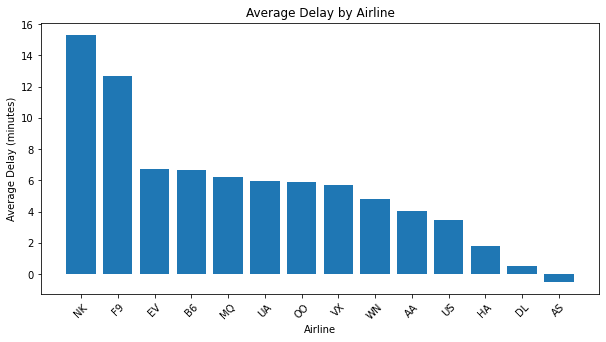

In [0]:
# Step 3.4: Visualizations
import matplotlib.pyplot as plt

# Convert average delay query result to Pandas for plotting
avg_delay_pd = avg_delay_df.toPandas()

plt.figure(figsize=(10, 5))
plt.bar(avg_delay_pd["AIRLINE"], avg_delay_pd["AVG_DELAY"])
plt.title("Average Delay by Airline")
plt.xlabel("Airline")
plt.ylabel("Average Delay (minutes)")
plt.xticks(rotation=45)
plt.show()


**The graph shows a visual representation of the query for average delay by airline where NK has highest delays of around 15 minutes,followed by F9,EV,etc.**

### Visualizing delays by day of the week:

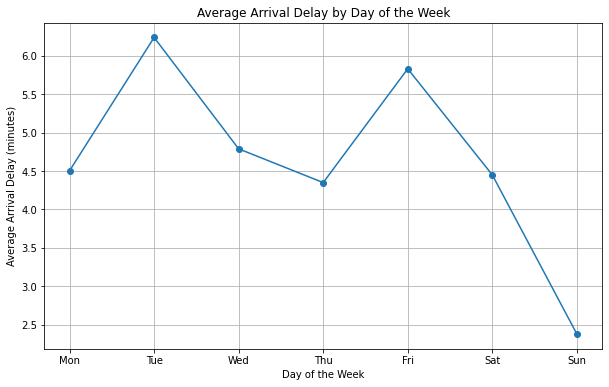

In [0]:
# SQL query to calculate the average delay by day of the week
avg_delay_by_day = spark.sql("""
    SELECT DAY_OF_WEEK AS Day, 
           AVG(ARRIVAL_DELAY) AS Average_Delay
    FROM flights
    GROUP BY DAY_OF_WEEK
    ORDER BY Day
""")

# Convert to Pandas DataFrame for plotting
avg_delay_day_pd = avg_delay_by_day.toPandas()

# Plot the average delay by day of the week
plt.figure(figsize=(10, 6))
plt.plot(avg_delay_day_pd['Day'], avg_delay_day_pd['Average_Delay'], marker='o')
plt.xlabel('Day of the Week')
plt.ylabel('Average Arrival Delay (minutes)')
plt.title('Average Arrival Delay by Day of the Week')
plt.xticks(range(1, 8), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.grid(True)
plt.show()


**The graph above shows  average arrival delay (in minutes) by the day of the week. Here are some insights from the plot:**

- **Tuesday and Friday Peaks:**

The highest average delays occur on Tuesday (around 6 minutes) and Friday. These could be high traffic days or days with increased operational challenges.

- **Sunday Low:**

The average arrival delay is the lowest on Sunday, dropping significantly to around 2.5 minutes. This could indicate lower traffic volumes or smoother operations on weekends.

- **Midweek Stability:**

Delays remain relatively stable between Monday, Wednesday, and Thursday, averaging around 4.5 to 5 minutes. There isn't a significant fluctuation during these days.

- **Saturday Decline:**

There is a slight decline in delays on Saturday compared to Friday, suggesting fewer disruptions or less congestion.

### Potential Implications:
- Operational or traffic management teams could investigate Tuesday and Friday delays to understand root causes and improve efficiency.
- The reduced delays on weekends might suggest fewer flights or reduced operational complexity, which could serve as a benchmark for optimizing weekday performance.

### Visualizing delays by month:

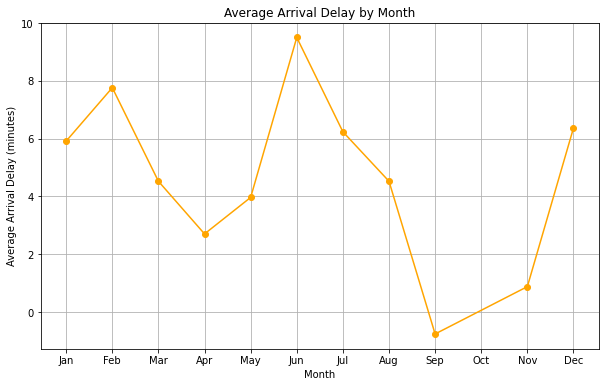

In [0]:
# SQL query to calculate the average delay by month
avg_delay_by_month = spark.sql("""
    SELECT MONTH AS Month, 
           AVG(ARRIVAL_DELAY) AS Average_Delay
    FROM flights
    GROUP BY MONTH
    ORDER BY Month
""")

# Convert to Pandas DataFrame for plotting
avg_delay_month_pd = avg_delay_by_month.toPandas()

# Plot the average delay by month
plt.figure(figsize=(10, 6))
plt.plot(avg_delay_month_pd['Month'], avg_delay_month_pd['Average_Delay'], marker='o', color='orange')
plt.xlabel('Month')
plt.ylabel('Average Arrival Delay (minutes)')
plt.title('Average Arrival Delay by Month')
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.show()


### Insights from Average Arrival Delay by Month

#### **Key Observations**

1. **June Peak**:
   - The highest average arrival delay occurs in **June**, reaching nearly **10 minutes**.
   - Likely due to increased travel demand during **summer vacations** or operational challenges.

2. **February High**:
   - **February** shows a relatively high average delay, around **8 minutes**.
   - This could be caused by **weather-related issues**, such as snow or storms in many regions.

3. **September Low**:
   - The lowest average arrival delay occurs in **September**, with delays dropping close to **0 minutes**.
   - Indicates fewer flights or **smoother operations** during this period.

4. **Late-Year Increase**:
   - Delays gradually increase in **November** and **December**, likely due to **holiday travel peaks** and **winter weather disruptions**.

5. **Spring Stability**:
   - **March, April, and May** show relatively low and consistent delays, averaging between **4 to 5 minutes**.
   - Reflects **stable operations** in spring.

6. **Post-Summer Decline**:
   - After the summer peak, delays steadily decline from **July** to **September**, suggesting **reduced congestion** or better weather conditions.

---

#### **Potential Implications**

1. **June Delays**:
   - Focus on strategies to improve **efficiency** and address **bottlenecks** during peak summer months.

2. **Weather Influence**:
   - Higher delays in **February** and late in the year may be linked to **adverse weather conditions**, requiring robust contingency planning.

3. **September Performance**:
   - The **excellent performance in September** could be analyzed for best practices to implement in other months.


### Questions:
1. **Which airlines had the highest average delays?**

**Ans 1: NK (Spirit Airlines)** has the highest average delay time of 15.31 minutes, indicating that it experiences more delays than other airlines. This could be due to operational challenges or other factors such as airport congestion or weather disruptions that affect its flights more often.

2. **What patterns did you observe in delays by day of the week?**

**Ans 2:**
### Patterns Observed in Delays by Day of the Week

#### 1. **Peak Delays on Tuesday and Friday**
- The **highest average delays** occur on **Tuesday** and **Friday**, indicating possible traffic congestion or operational challenges.
- This trend could be linked to **midweek business travel** or **increased demand before the weekend**.

#### 2. **Low Delays on Sunday**
- **Sunday** shows the **lowest average delay**, around **2.5 minutes**.
- This suggests fewer flights, reduced operational pressure, or lower travel demand compared to weekdays.

#### 3. **Midweek Stability (Monday to Thursday)**
- Delays are relatively stable and moderate during **Monday**, **Wednesday**, and **Thursday**, hovering between **4.5 to 5 minutes**.
- These days appear less prone to significant disruptions.

#### 4. **Slight Improvement on Saturday**
- Delays decline slightly on **Saturday** compared to Friday, likely due to reduced traffic or smoother operations.

### General Trend
- **Delays peak on busier days** (Tuesday and Friday) and **drop significantly over the weekend**, especially on **Sunday**, when operations appear most efficient.


## Model Building: Random Forest Regressor

In [0]:
# Import required libraries

from pyspark.ml import Pipeline
from pyspark.sql.functions import col
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from pyspark.ml.feature import VectorAssembler


In [0]:
 # Step 1: Feature Selection and Vectorization
# Selecting relevant features for prediction
# Step 2: Assemble the features (including the newly indexed columns)
feature_columns = [
    'DAY_OF_WEEK', 'MONTH', 
    'DEPARTURE_DELAY', 'TAXI_OUT', 'WHEELS_OFF', 'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE',
    'WHEELS_ON', 'TAXI_IN', 'SCHEDULED_ARRIVAL'
]



In [0]:
# Assemble features into a feature vector
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")

In [0]:
# Step 3: Define the RandomForestRegressor Model
rf = RandomForestRegressor(featuresCol="features", labelCol="ARRIVAL_DELAY", numTrees=100)


In [0]:

# Step 4: Create a Pipeline with StringIndexer and RandomForest
pipeline = Pipeline(stages=[ assembler, rf])



In [0]:
# Step 5: Train-Test Split
# Split the data into training and testing sets (70% train, 30% test)
train_data, test_data = flights_df.randomSplit([0.7, 0.3], seed=42)

In [0]:
# Step 6: Fit the Model
# Train the model using the training data
model = pipeline.fit(train_data)


In [0]:
# Step 7: Model Evaluation
# Make predictions on the test data
predictions = model.transform(test_data)

In [0]:
# Evaluators for different metrics
evaluator_rmse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="rmse")
evaluator_r2 = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="r2")
evaluator_mae = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mae")
evaluator_mse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mse")





In [0]:

# Calculate the metrics
rmse = evaluator_rmse.evaluate(predictions)
r2 = evaluator_r2.evaluate(predictions)
mae = evaluator_mae.evaluate(predictions)
mse = evaluator_mse.evaluate(predictions)


In [0]:
# Print the metrics
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"R2 (Coefficient of Determination): {r2}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Squared Error (MSE): {mse}")


Root Mean Squared Error (RMSE): 20.626947599800847
R2 (Coefficient of Determination): 0.7243615493335072
Mean Absolute Error (MAE): 10.61687625678402
Mean Squared Error (MSE): 425.47096728492994


## INSIGHTS DERIVED FROM METRICS:
1. **An RMSE of 20.63 minutes** means that, on average, the model's prediction is off by about 20.63 minutes. A lower RMSE indicates better predictive accuracy. The model has a moderate level of error, meaning it's not perfectly predicting arrival delays but is reasonably accurate.

2. **An R² of 0.72** means the model explains 72% of the variance in arrival delays. This is a good result, indicating that the model captures most of the underlying patterns in the data. However, there's still some unexplained variance (28%), meaning the model could be further refined to improve accuracy.

3. **An MAE of 10.62 minutes** means that, on average, the model’s predictions are off by 10.62 minutes. MAE is generally easier to interpret than RMSE since it gives a simple average of prediction errors, but it doesn't penalize large errors as much as RMSE does.

4. **MSE of 425.47** means that, on average, the squared differences between the predicted and actual arrival delays are 425.47. The larger MSE value, compared to MAE, suggests that there are some significant errors that are being penalized more heavily.

In [0]:
# Step 8: Display Model Results

# Show the predictions for the first 10 rows
predictions.select("ARRIVAL_DELAY", "prediction").show(10)



+-------------+-------------------+
|ARRIVAL_DELAY|         prediction|
+-------------+-------------------+
|         -5.0|-3.4284959665448245|
|         -1.0| -4.627208601005327|
|         16.0| 11.481428423548175|
|         27.0|  5.923246816429543|
|         -9.0| -8.180458291966646|
|        137.0|  128.1128000772876|
|          8.0|-3.0668194329123843|
|         -5.0|   -6.1207915918483|
|         -5.0|-7.8231990145418475|
|         10.0| -7.747003290882247|
+-------------+-------------------+
only showing top 10 rows



**It is evident that model's predictions is deviating significantly from actual arrival delays, with some underpredictions (e.g., ARRIVAL_DELAY=27 predicted as 5.92) and overpredictions (e.g., ARRIVAL_DELAY=8 predicted as -3.07). This indicates room for improvement in accuracy and suggests the need for better tuning**

## Hyperparameter Tuning for Random Forest 

In [0]:
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import RegressionEvaluator
import random

In [0]:
# Take a random subset of the data (e.g., 10% of the total data)
subset_data = flights_df.sample(fraction=0.1, seed=42)

# Split the subset into training and test data
train_data, test_data = subset_data.randomSplit([0.8, 0.2], seed=42)

In [0]:
# Transform the data to include the 'features' column
train_data_assembled = assembler.transform(train_data)
test_data_assembled = assembler.transform(test_data)

In [0]:
# Define Random Forest model
rf = RandomForestRegressor(featuresCol="features", labelCol="ARRIVAL_DELAY")

# Generate random combinations for hyperparameters
paramGrid = ParamGridBuilder()
num_trees_values = random.sample(range(10, 200), 5)  # Randomly sample 5 values for numTrees
max_depth_values = random.sample(range(5, 20), 3)    # Randomly sample 3 values for maxDepth
max_bins_values = random.sample(range(32, 100), 3)   # Randomly sample 3 values for maxBins

for num_trees in num_trees_values:
    paramGrid.addGrid(rf.numTrees, [num_trees])

for max_depth in max_depth_values:
    paramGrid.addGrid(rf.maxDepth, [max_depth])

for max_bins in max_bins_values:
    paramGrid.addGrid(rf.maxBins, [max_bins])

paramGrid = paramGrid.build()

In [0]:
# Define evaluator
evaluator = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="rmse")




In [0]:
# Define CrossValidator
crossval = CrossValidator(estimator=rf,
                          estimatorParamMaps=paramGrid,
                          evaluator=evaluator,
                          numFolds=3)  # 3-Fold Cross-Validation

In [0]:
# Train the model using Randomized Search
cv_model = crossval.fit(train_data_assembled)



In [0]:
# Best model
best_model = cv_model.bestModel


In [0]:
# Initialize evaluators
evaluator_rmse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="rmse")
evaluator_r2 = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="r2")
evaluator_mae = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mae")
evaluator_mse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mse")



In [0]:
# Compute metrics
rmse = evaluator_rmse.evaluate(predictions)
r2 = evaluator_r2.evaluate(predictions)
mae = evaluator_mae.evaluate(predictions)
mse = evaluator_mse.evaluate(predictions)

In [0]:
# Print results
print("Evaluation Metrics for the Best Model:")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"R² (Coefficient of Determination): {r2}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Squared Error (MSE): {mse}")

Evaluation Metrics for the Best Model:
Root Mean Squared Error (RMSE): 13.450413922988949
R² (Coefficient of Determination): 0.8827963414488774
Mean Absolute Error (MAE): 7.924792435351505
Mean Squared Error (MSE): 180.91363469973496


In [0]:
# Show the predictions for the first 10 rows
predictions.select("ARRIVAL_DELAY", "prediction").show(10)

+-------------+-------------------+
|ARRIVAL_DELAY|         prediction|
+-------------+-------------------+
|         -5.0| -4.053837277898307|
|         -1.0|-2.1034349081555743|
|         16.0| 13.854460140311375|
|         27.0| 16.537606907709566|
|         -9.0|-11.823349962675628|
|        137.0|   120.433688661258|
|          8.0| -4.207589760299394|
|         -5.0| -6.223542885846673|
|         -5.0|-10.382456571399441|
|         10.0| -12.46038553797361|
+-------------+-------------------+
only showing top 10 rows



**As we can see, even the predictions are better than before and much closer to the actual values**

### Comparison of Model Performance before and after Hyperparameter Tuning:

- **RMSE: 13.45**  
  After hyperparameter tuning, the error dropped significantly, indicating a better fit of the model. On average, the predictions now differ by 13.45 minutes, a marked improvement over the untuned model.

- **R²: 0.88**  
  The tuned model explains about 88% of the variance in arrival delay, which is a substantial improvement from 72%. This means the model has become much more effective at capturing the patterns in the data.

- **MAE: 7.92**  
  The absolute error between predicted and actual delays has dropped significantly, which suggests the model's predictions are now more accurate.

- **MSE: 180.91**  
  The MSE has decreased, indicating a reduction in larger prediction errors. This is a positive sign, showing that the tuned model produces more stable and less error-prone predictions.


### Insights in Terms of Arrival Delay:

- **Reduction in Prediction Error (RMSE):**  
  After hyperparameter tuning, the RMSE decreased from 20.63 minutes to 13.45 minutes, indicating more accurate predictions for arrival delays. This results in more reliable scheduling and planning.

- **Better Variance Explanation (R²):**  
  The R² improved from 0.72 to 0.88, meaning the tuned model explains 88% of the variance in arrival delays, capturing more of the factors that influence delays and enhancing the ability to predict arrival times.

- **More Accurate Average Predictions (MAE):**  
  The MAE reduced from 10.62 minutes to 7.92 minutes, reflecting improved accuracy in predicting average arrival delays. This helps in precise decision-making, such as gate assignments and crew scheduling.

- **Lower Impact of Outliers (MSE):**  
  MSE dropped from 425.47 to 180.91, indicating that the model is now less sensitive to large errors. It predicts extreme delays more accurately, minimizing the effect of outliers on overall predictions.

- **Improved Operational Efficiency:**  
  The improvements in error metrics and R² mean that arrival delay predictions are more reliable, aiding operational decisions like resource allocation and proactive delay management, ultimately improving efficiency and customer satisfaction.

In conclusion, hyperparameter tuning has significantly enhanced the model's accuracy, providing more reliable predictions for operational decision-making.


### Conclusion 
In conclusion, through this project I not only gained insights into the flight delays dataset but also developed a robust predictive model capable of forecasting flight delays. The application of PySpark and Spark SQL provided a scalable and efficient approach to handle and analyze large datasets. Hyperparameter tuning further enhanced the model's performance, demonstrating the importance of optimizing machine learning models for real-world applications.